# AI Tech Challange - Child Seat Location

**This is a script for data preprocessing.**
* Data set used: [SVIRO](https://sviro.kl.dfki.de/) e [TICaM](https://vizta-tof.kl.dfki.de/cabin-dataset/)
* Made by: Dr. Ilan Sousa Figueiredo

## Data set SVIRO

SVIRO was created to investigate and benchmark machine learning approaches for application in the passenger compartment regarding common challenges of realistic engineering applications. **In particular, SVIRO can be used to evaluate the generalization and robustness of machine learning models when trained on a limited number of variations.**

There are available human models, child seats and backgrounds. The data was splited for training images and test images.

The dataset consists of 10 different vehicle interiors and 25.000 sceneries in total. It has RGM images, grayscale images and depth images.

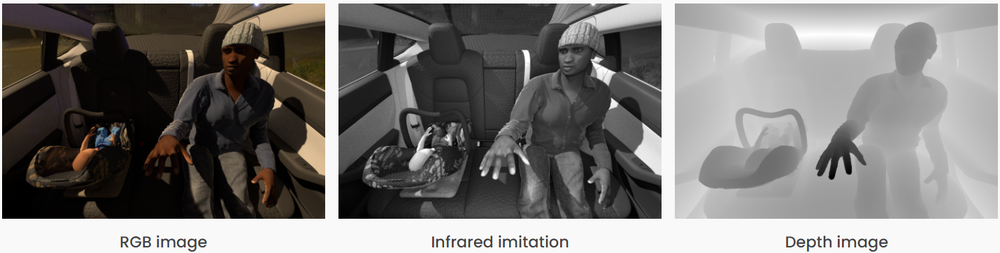

The SVIRO dataset's ground truth encompasses four distinct categories:

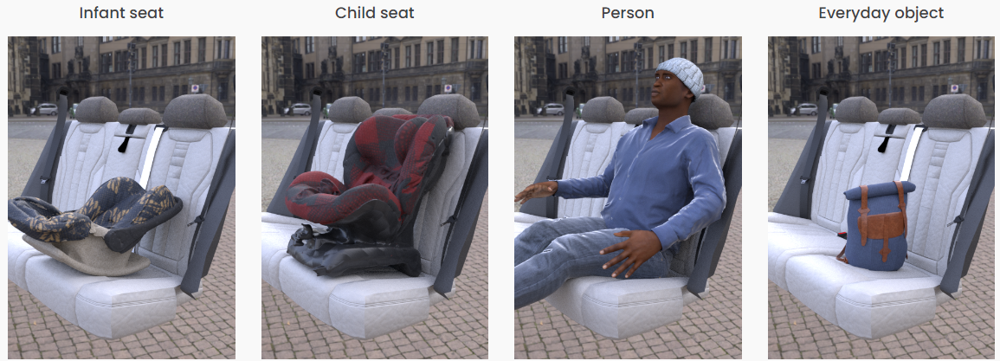

Note: the child and infant seats can either be (i) empty, or (ii) occupied by a baby or child respectively.

## Task chosen

The dataset is labelling for many possible task, which basically are (In bold the chosen one for this challenge):
* Classification
* Segmentation
* **Object detction**
* Keypoints estimation

### Justification

As we aim to pinpoint the child seat's location, tasks like keypoint estimation and classification aren't the most suitable choices. This leaves us with the options of Segmentation and Object Detection.

For this challenge, **I have opted to develop a deep learning Object Detection model** for locating the child seat. This choice is motivated by the potential need for a compact model that can be embedded within a car's microprocessor (MPU). Object detection machine learning models typically have a lower computational footprint compared to Segmentation models. Furthermore, object detection proves sufficient to locate the child seat within the passenger vehicle, eliminating the need for extensive computational resources. Additionally, I must consider the time constraint of the challenge.

## Bounding Boxes

The Data set provided a single text file which contains the bounding boxes of all objects in the scene. Here is an example of images with bounding boxes:

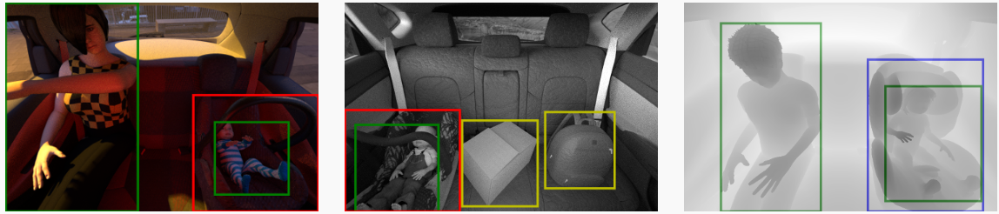

## Ground truth labels

The table below has the ground truth labels associated with the different objects for the different tasks:

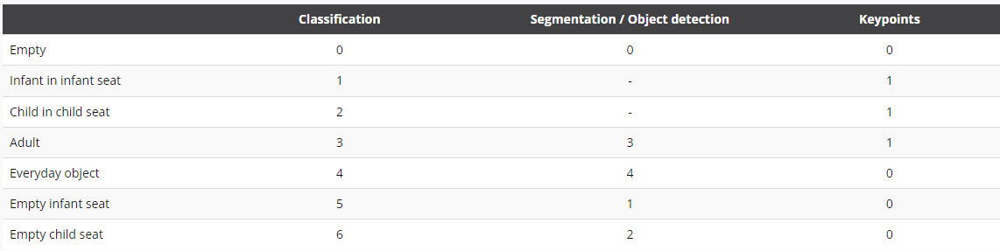

So, the **bounding boxes** has the following informations:
0. Empty
1. Empty infant seat
2. **Empty child seat**
3. Person
4. Everyday object

**Important:** the bounding boxes labels assume that the origin of the images is at the upper left corner. The coordinates of the bounding boxes are in the following format:



The primary objective of this challenge is to precisely determine the location of a child's seat, excluding any other unrelated information from the model's training dataset. However, two distinct scenarios involving the child seat may arise: (i) an unoccupied child seat or (ii) a child seat with a child present. Consequently, only data pertaining to these specific scenarios will be taken into consideration. This filtration process can be effectively implemented by examining the file names, which have been structured as follows:"



Therefore, we only used data that had classes 2 and 6 in the name.

## Importing Python libraries

In [1]:
import pandas as pd
import numpy as np
import zipfile
import os, glob
import matplotlib.pyplot as plt
import csv
import matplotlib.patches as patches
import torch
from PIL import Image
import shutil
import matplotlib.image as mpimg
from dataloader_bounding_boxes import SVIRODetection, my_collate_fn, plot_image_and_bbs

## Functions

In [3]:
def bbox_preprocessing_sviro(in_path, out_path, cars, train_valid, color, only_child_seat=True, copy_image=False):
    
    for car in cars:
        
        print(f'Car:', car)
        
        for train_val in train_valid:

            labels_path = glob.glob(os.path.join(in_path, car, train_val, 'boundingBoxes_wholeImage/*.txt'))
            images_path = glob.glob(os.path.join(in_path, car, train_val, color, '*.png'))

            print(f'Data:', train_val)
            print('Amount of images:',len(images_path))
            print('Amount of labels:',len(labels_path))
            print()

            if only_child_seat:

                if train_val == 'train':

                    # we do want to use only child seat data for training 
                    labels_path = [element for element in labels_path if "_2" in str(element.split('GT')[-1]) or "_6" in str(element.split('GT')[-1])]
                    images_path = [element for element in images_path if "_2" in str(element.split('GT')[-1]) or "_6" in str(element.split('GT')[-1])]

                c = [2] # only child seat class

                print('Removing data that does not have a child seat')
                print('Amount of images:',len(images_path))
                print('Amount of labels:',len(labels_path))
                print()

            else:
                c = [0,1,2,3,4] # all classes

            # loop
            for label_path, image_path in zip(labels_path, images_path):

                # separate directory path and file name   
                _, label_filename = os.path.split(label_path)
                _, image_filename = os.path.split(image_path)

                # reading label
                bounding_box_data  = np.loadtxt(label_path, dtype=str)
        #         print('label_path:',label_path)
        #         print('label shape:', np.shape(bounding_box_data))

                # reading image
                image = Image.open(image_path)#.convert('L')

                # reshape bbox with one row
                if np.shape(bounding_box_data) == ():
                    bounding_box_data = bounding_box_data.flatten()

                # loop per row of the bounding box file
                bbox_normalized = []
                for row in bounding_box_data: 
                    class_label, x_upper_left_corner, y_upper_left_corner, x_lower_right_corner, y_lower_right_corner = map(float, row.split(','))

                    if class_label in c:
                        class_label = int(0) # one class

                        # altura da imagem
                        H = np.shape(image)[0]

                        # largura da imagem
                        W = np.shape(image)[1]

                        # Calculate center coordinates (x_center, y_center)
                        x_center = (x_upper_left_corner + x_lower_right_corner) / 2.0
                        y_center = (y_upper_left_corner + y_lower_right_corner) / 2.0

                        # Calculate width and height
                        width = x_lower_right_corner - x_upper_left_corner
                        height = y_lower_right_corner - y_upper_left_corner

                        # Normalize bounding box coordinates and dimensions
                        x_center_normalized = x_center / W
                        y_center_normalized = y_center / H
                        width_normalized = width / W
                        height_normalized = height / H

                        # The normalized bounding box format would be [class_label, x_center_normalized, y_center_normalized, width_normalized, height_normalized]
                        converted_row = f'{int(class_label)} {x_center_normalized} {y_center_normalized} {width_normalized} {height_normalized}'
                        bbox_normalized.append(converted_row)

                # saving normalized bounding box labels
                destination_directory_bbox = os.path.join(OUT_PATH, train_val, 'labels')
                os.makedirs(destination_directory_bbox,exist_ok=True)
                full_path_bbox = os.path.join(destination_directory_bbox, label_filename)

                with open(full_path_bbox, "w") as outfile:
                    np.savetxt(outfile, bbox_normalized, fmt='%s')

                print(f"Bounding box saved: {full_path_bbox}.")

                if copy_image:

                    # coping image
                    destination_directory_img = os.path.join(OUT_PATH, train_val, 'images')
                    os.makedirs(destination_directory_img,exist_ok=True)
                    full_path_img = os.path.join(destination_directory_img, image_filename)

                    # Copy the image
                    shutil.copy(image_path, full_path_img)

                    print(f"Image file copied: {full_path_img}.")
                    print()

    return  

In [2]:
def bbox_preprocessing_ticam (in_path, out_path, color, only_child_seat=True, copy_image=False):

    labels_path = glob.glob(os.path.join(in_path, 'Synthetic_labels/boundingBoxes_wholeImage/*.txt'))
    images_path = glob.glob(os.path.join(in_path, 'Synthetic_images',color,'*.png'))
    
    print('Amount of images:',len(images_path))
    print('Amount of labels:',len(labels_path))
    print()

    if only_child_seat:

        # we do want to use only child seat data for training 
        labels_path = [element for element in labels_path if "_2" in str(element.split('GT')[-1]) or "_6" in str(element.split('GT')[-1])]
        images_path = [element for element in images_path if "_2" in str(element.split('GT')[-1]) or "_6" in str(element.split('GT')[-1])]

        c = [6] # only child seat class (2: child in a child seat, 6: empty child seat)

        print('Removing data that does not have a child seat')
        print('Amount of images:',len(images_path))
        print('Amount of labels:',len(labels_path))
        print()

    else:
        c = [0,1,2,3,4,5,6] # all classes

    # loop
    for label_path, image_path in zip(labels_path, images_path):

        # separate directory path and file name   
        _, label_filename = os.path.split(label_path)
        _, image_filename = os.path.split(image_path)

        # reading label
        bounding_box_data  = np.loadtxt(label_path, dtype=str)
#         print('label_path:',label_path)
#         print('label shape:', np.shape(bounding_box_data))

        # reading image
        image = Image.open(image_path)#.convert('L')

        # reshape bbox with one row
        if np.shape(bounding_box_data) == ():
            bounding_box_data = bounding_box_data.flatten()

        # loop per row of the bounding box file
        bbox_normalized = []
        for row in bounding_box_data: 
            class_label, x_upper_left_corner, y_upper_left_corner, x_lower_right_corner, y_lower_right_corner = map(float, row.split(','))

            if class_label in c:
                class_label = int(2) # one class

                # altura da imagem
                H = np.shape(image)[0]

                # largura da imagem
                W = np.shape(image)[1]

                # Calculate center coordinates (x_center, y_center)
                x_center = (x_upper_left_corner + x_lower_right_corner) / 2.0
                y_center = (y_upper_left_corner + y_lower_right_corner) / 2.0

                # Calculate width and height
                width = x_lower_right_corner - x_upper_left_corner
                height = y_lower_right_corner - y_upper_left_corner

                # Normalize bounding box coordinates and dimensions
                x_center_normalized = x_center / W
                y_center_normalized = y_center / H
                width_normalized = width / W
                height_normalized = height / H

                # The normalized bounding box format would be [class_label, x_center_normalized, y_center_normalized, width_normalized, height_normalized]
                converted_row = f'{int(class_label)} {x_center_normalized} {y_center_normalized} {width_normalized} {height_normalized}'
                bbox_normalized.append(converted_row)

        # saving normalized bounding box labels
        destination_directory_bbox = os.path.join(OUT_PATH, 'train/labels')
        os.makedirs(destination_directory_bbox,exist_ok=True)
        full_path_bbox = os.path.join(destination_directory_bbox, label_filename)

        with open(full_path_bbox, "w") as outfile:
            np.savetxt(outfile, bbox_normalized, fmt='%s')

        print(f"Bounding box saved: {full_path_bbox}.")

        if copy_image:

            # coping image
            destination_directory_img = os.path.join(OUT_PATH, 'train/images')
            os.makedirs(destination_directory_img,exist_ok=True)
            full_path_img = os.path.join(destination_directory_img, image_filename)

            # Copy the image
            shutil.copy(image_path, full_path_img)

            print(f"Image file copied: {full_path_img}.")
            print()

    return    

## Reading Data set SVIRO

Once the data has been downloaded, unzipped and organized into a directory, it is recommended to explore a portion of the data visually.

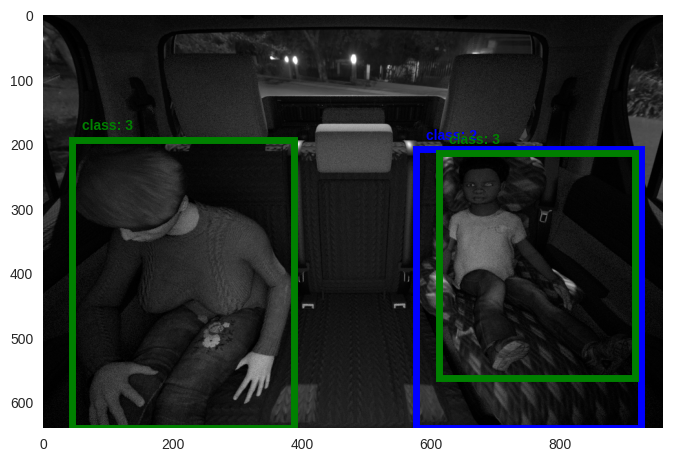

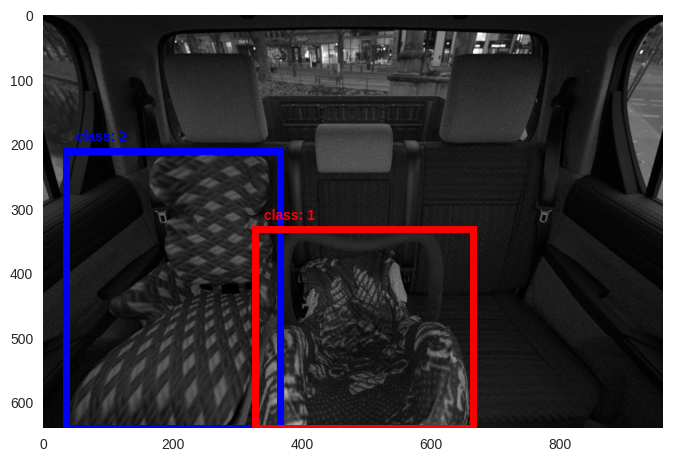

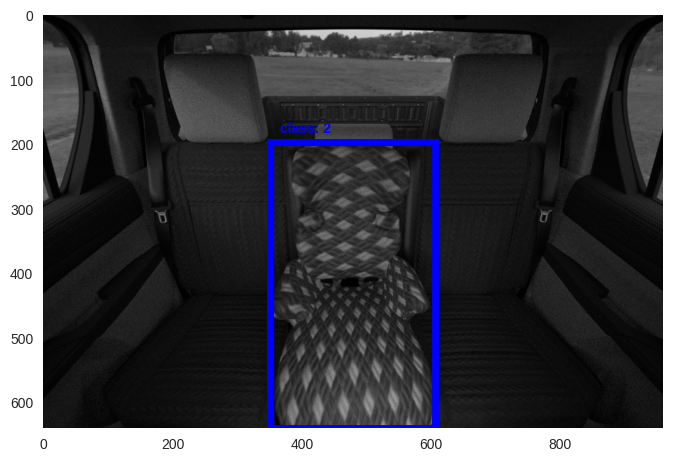

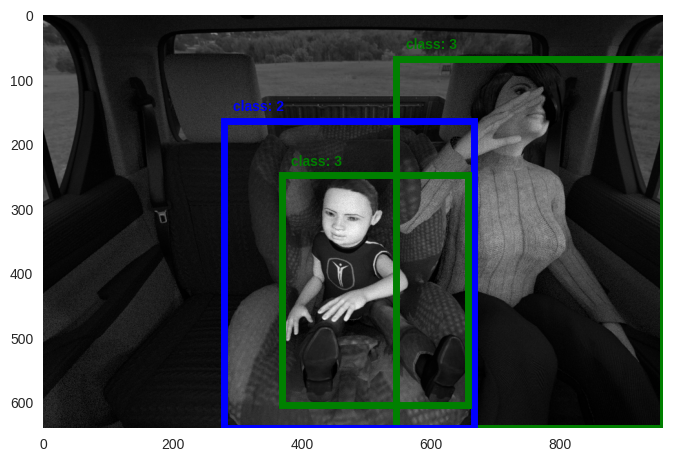

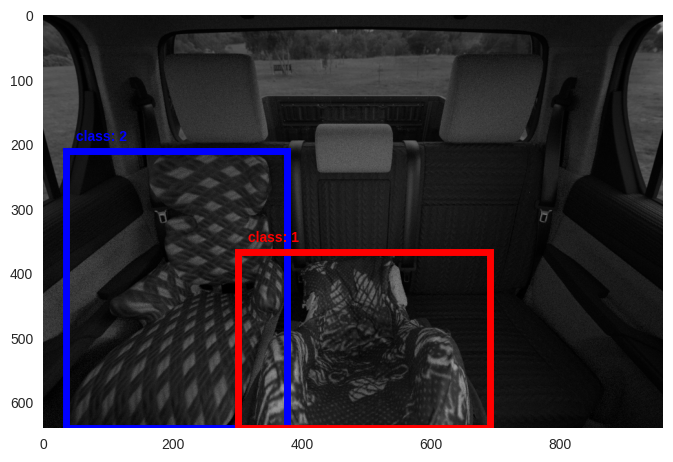

...

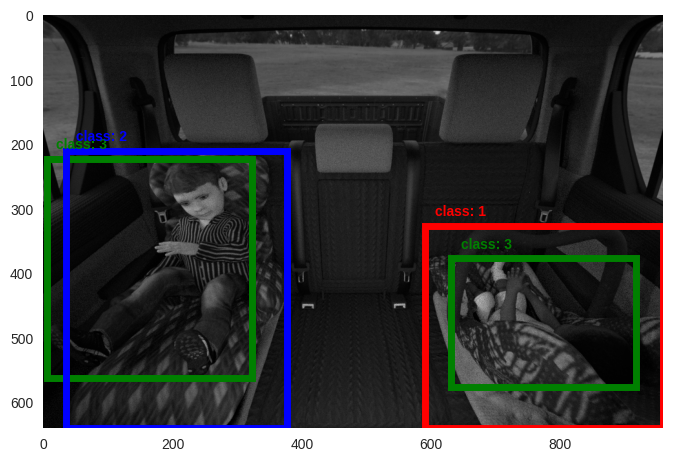

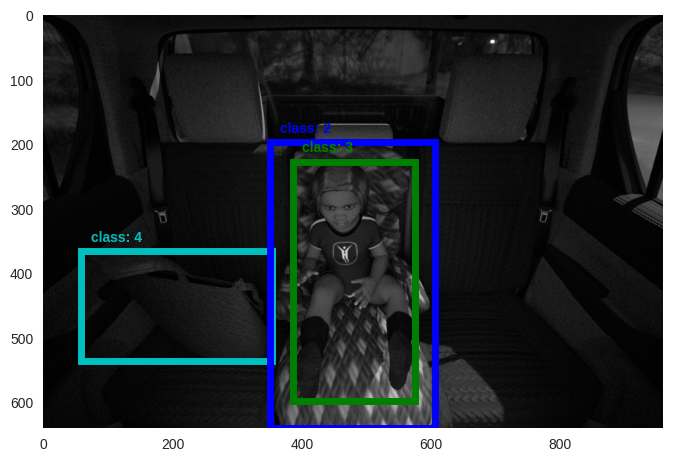

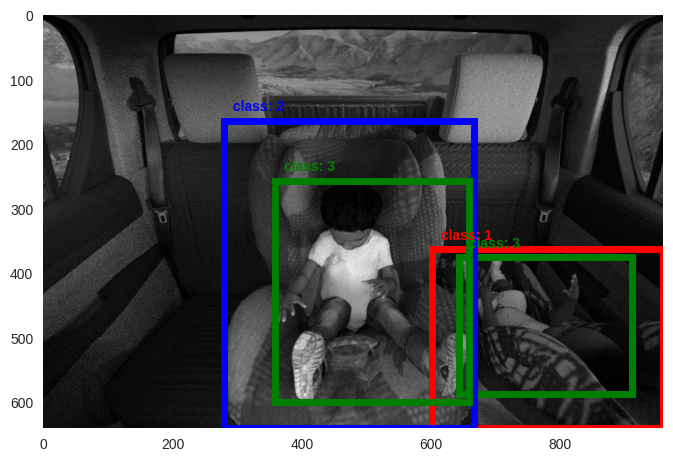

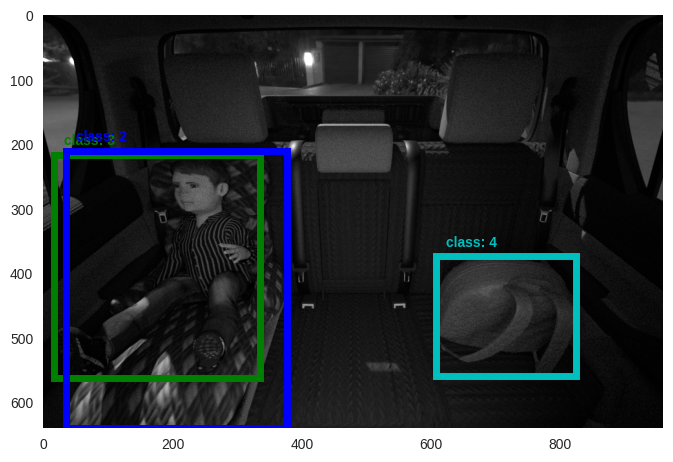

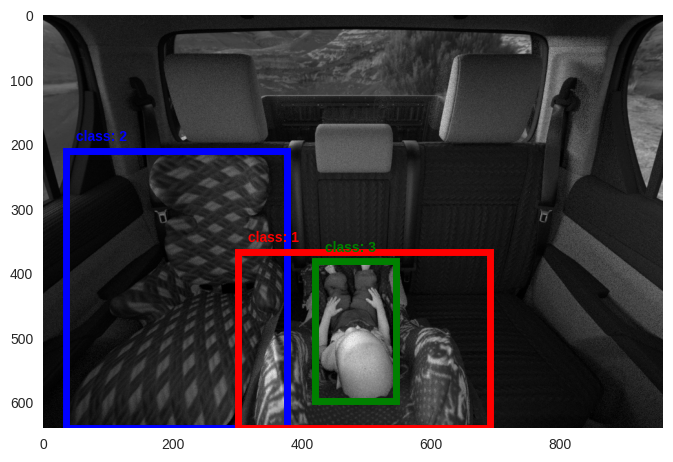

In [2]:
# function source: https://github.com/SteveCruz/sviro_helperfunctions
# Slight adjustments were made to filter images containing child seats

# define dataset config parameters
root = './unzip_data'
car = "hilux"
split = "train"

# number of classes, if we select 4 classes, everyday objects are considered as background, if 1, only child seat is considered
nbr_classes = 1

# get the dataset
dataset = SVIRODetection(root=root, car=car, split=split, nbr_classes=nbr_classes)

# create loader for the defined dataset
train_loader = torch.utils.data.DataLoader(
    dataset,
    batch_size=16, 
    shuffle=False, 
    num_workers=20, 
    pin_memory=False,
    collate_fn=my_collate_fn
)

# for each batch
for batch_images, batch_boxes in train_loader:

    # plot first image of batch with the bounding boxes
    plot_image_and_bbs(batch_images[0], batch_boxes[0])

## Exploratory Data Analysis

The SVIRO dataset is rich in information readily available on websites and in articles. Consequently, statistical insights about the data can be conveniently gleaned from these sources, thus saving time during the data analysis process. This approach aligns with the challenge's emphasis on prioritizing algorithm development over broader application aspects.

Here is some pertinent information available:

* The number of people and the distribution of the gender, age and ethnicity for the training and test set

  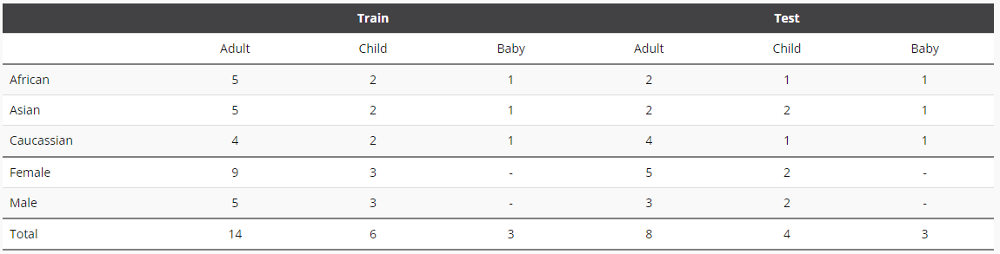

*  The vehicles in the training and test sets are identical
*  In total, there are 20,000 training scenes and 5,000 test scenes.
*  Here is the distribution of the various classes across different vehicles and data splits:

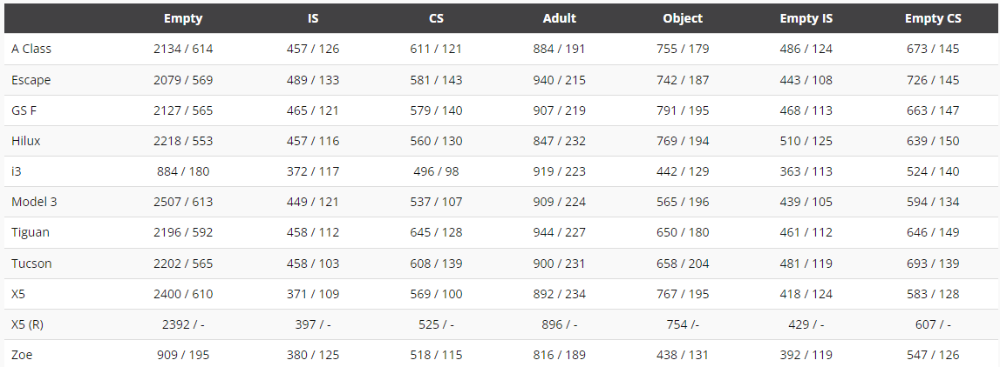
IS: infant seat, CS: child seat

## Preprocessing

Since visually the data appear to have a good labeling (also because they are synthetic data), a series of preprocessing steps are essential to prepare it for model training. **The actions taken were:**

* Converting labels to the following format: *class x_center y_center width height*
* Labels with one row per object
* Normalized of bouding Box coordinates to xywh format (from 0 - 1)
* Removing the coordinates of objects other than the child's seat
* Removal of images that did not have a child seat (for training purposes only)
* Exclusively utilizing grayscale images for the training dataset

The choice of grayscale images is because this images contain only one channel of luminance intensity, as opposed to the three RGB channels in color images. This can make processing more efficient, which can be important in scenarios where computational resources and time are limited.  Beside, grayscale is less affected by lighting and color variations (example below), which can be advantageous for detection tasks since you can focus more on the object details themselves.

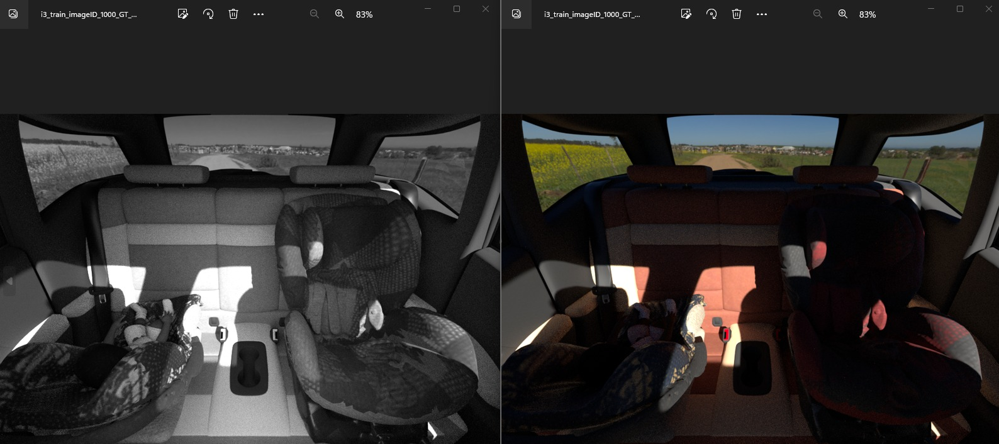

**There was no need to:**
* Normalize the images (0.1)
* Resize the images
* Data augmentation
* Split between train and test data.

This is because the chosen pre-trained model already has these actions, according to [documentation](https://github.com/ultralytics/yolov5/tree/master). **Furthermore, it is not advisable to augment the dataset, as the YOLOv5 model already incorporates data augmentation techniques**. The SVIRO dataset is already subdivided between training and testing. The training script provides more information.

### Preprocessing Sviro Data

In [5]:
IN_PATH = './unzip_data'
OUT_PATH = './datasets/sviro'
CARS = ['i3','random_x5','tucson','x5','zoe','aclass','escape','gsf','tiguan','model3','hilux']
TRAIN_VAL = ['train','test_with_labels']
COLOR = 'grayscale_wholeImage'
# COLOR = 'RGB_wholeImage'

In [6]:
bbox_preprocessing_sviro(IN_PATH, OUT_PATH, CARS, TRAIN_VAL, COLOR, only_child_seat=True, copy_image=True)

Car: i3
Data: train
Amount of images: 2000
Amount of labels: 2000

Removing data that does not have a child seat
Amount of images: 904
Amount of labels: 904

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/labels/i3_train_imageID_1188_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/images/i3_train_imageID_1757_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/labels/i3_train_imageID_1520_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/images/i3_train_imageID_1213_GT_0_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/labels/i3_train_imageID_1235_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/images/i3_train_imageID_768_GT_6_0_3.png.

Bou

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/i3/test_with_labels/boundingBoxes_wholeImage/i3_test_imageID_245_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_116_GT_0_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_478_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_492_GT_6_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_179_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_314_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_125_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_label

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/i3/test_with_labels/boundingBoxes_wholeImage/i3_test_imageID_329_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_342_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_405_GT_6_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_468_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_415_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_388_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_207_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_label

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/i3/test_with_labels/boundingBoxes_wholeImage/i3_test_imageID_487_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_46_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_432_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_353_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_81_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_475_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_372_GT_2_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/i3/test_with_labels/boundingBoxes_wholeImage/i3_test_imageID_390_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_302_GT_0_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_219_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_24_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_499_GT_6_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_159_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_335_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/i3/test_with_labels/boundingBoxes_wholeImage/i3_test_imageID_418_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_418_GT_0_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_298_GT_4_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_199_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_72_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/i3_test_imageID_407_GT_4_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/i3_test_imageID_64_GT_2_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/tucson/test_with_labels/boundingBoxes_wholeImage/tucson_test_imageID_342_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/tucson_test_imageID_369_GT_4_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/tucson_test_imageID_365_GT_2_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/tucson_test_imageID_26_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/tucson_test_imageID_488_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/tucson_test_imageID_53_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/tucson_test_imageID_301_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/tucson/test_with_labels/boundingBoxes_wholeImage/tucson_test_imageID_217_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/labels/x5_train_imageID_24_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/images/x5_train_imageID_479_GT_5_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/labels/x5_train_imageID_378_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/images/x5_train_imageID_10_GT_2_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/labels/x5_train_imageID_483_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/images/x5_train_imageID_1637_GT_1_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/train/labels/x5_train_imageID_1986_GT_3_6_0.txt.
Image file copied: /home.nf

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/x5/test_with_labels/boundingBoxes_wholeImage/x5_test_imageID_10_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/x5_test_imageID_384_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/x5_test_imageID_102_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/x5_test_imageID_338_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/x5_test_imageID_353_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/x5_test_imageID_97_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/x5_test_imageID_208_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/x5/test_with_labels/boundingBoxes_wholeImage/x5_test_imageID_435_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/x5_test_imageID_313_GT_6_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/x5_test_imageID_393_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/x5_test_imageID_0_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/x5_test_imageID_124_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/x5_test_imageID_164_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/x5_test_imageID_138_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_473_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_29_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_18_GT_0_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_412_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_144_GT_4_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_93_GT_0_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_385_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_la

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_377_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)
/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_424_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)
/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_246_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_499_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_493_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_236_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_411_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_255_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_342_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_305_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_207_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_348_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_100_GT_0_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_318_GT_6_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_384_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_378_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_212_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)
/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_301_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)
/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_95_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)
/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/z

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_172_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_156_GT_6_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_81_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_93_GT_0_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_403_GT_0_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_3_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_lab

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_63_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_80_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_432_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_471_GT_6_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_344_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_248_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_307_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/zoe/test_with_labels/boundingBoxes_wholeImage/zoe_test_imageID_54_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_441_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_251_GT_6_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_159_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_460_GT_4_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/zoe_test_imageID_46_GT_1_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/zoe_test_imageID_97_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_l

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/aclass/test_with_labels/boundingBoxes_wholeImage/aclass_test_imageID_451_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_9_GT_6_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_11_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_303_GT_2_1_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_220_GT_4_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_348_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_273_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/aclass/test_with_labels/boundingBoxes_wholeImage/aclass_test_imageID_120_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)
/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/aclass/test_with_labels/boundingBoxes_wholeImage/aclass_test_imageID_356_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_56_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_419_GT_2_4_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_36_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_349_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_449_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_69_GT_5_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/aclass/test_with_labels/boundingBoxes_wholeImage/aclass_test_imageID_96_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_352_GT_2_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_214_GT_1_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_228_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_222_GT_4_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_341_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_119_GT_5_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sv

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/aclass/test_with_labels/boundingBoxes_wholeImage/aclass_test_imageID_393_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_372_GT_6_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_430_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_259_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_231_GT_3_4_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/aclass_test_imageID_54_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/aclass_test_imageID_132_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/tiguan/test_with_labels/boundingBoxes_wholeImage/tiguan_test_imageID_92_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/tiguan_test_imageID_407_GT_5_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/tiguan_test_imageID_291_GT_5_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/tiguan_test_imageID_103_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/tiguan_test_imageID_398_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/tiguan_test_imageID_467_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/tiguan_test_imageID_363_GT_0_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sv

/tmp/ipykernel_89706/2879369902.py:43: UserWarning: loadtxt: input contained no data: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/hilux/test_with_labels/boundingBoxes_wholeImage/hilux_test_imageID_151_GT_0_0_0.txt"
  bounding_box_data  = np.loadtxt(label_path, dtype=str)


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/hilux_test_imageID_123_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/hilux_test_imageID_341_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/hilux_test_imageID_319_GT_4_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/hilux_test_imageID_36_GT_1_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/labels/hilux_test_imageID_113_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_norm/test_with_labels/images/hilux_test_imageID_402_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_nor

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_147_GT_4_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_330_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_45_GT_6_1_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_270_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_422_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_315_GT_2_0_4.png.

Bounding box saved: /ho

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_51_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_51_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_247_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_473_GT_6_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_143_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_453_GT_0_0_4.png.

Bounding box saved: /hom

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_161_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_194_GT_5_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_112_GT_3_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_241_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_269_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_246_GT_1_4_0.png.

Bounding box saved: /h

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_227_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_29_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_391_GT_6_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_264_GT_0_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_282_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_466_GT_5_0_0.txt.
Image file copied: /hom

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_137_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_354_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_471_GT_3_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_297_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_267_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_16_GT_3_0_6.png.

Bounding box saved: /ho

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_302_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_117_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_102_GT_6_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_35_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_125_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_346_GT_5_0_0.txt.
Image file copied: /hom

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_488_GT_4_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_469_GT_3_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_84_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_47_GT_4_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_271_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_119_GT_6_4_0.png.

Bounding box saved: /hom

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_383_GT_3_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_444_GT_2_1_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_268_GT_6_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_192_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/escape_test_imageID_486_GT_1_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/escape_test_imageID_215_GT_4_0_2.png.

Bounding box saved: /h

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1327_GT_1_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1215_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_335_GT_4_6_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_535_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1563_GT_6_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_574_GT_0_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_888_GT_0_6_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1461_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1269_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_653_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_435_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_252_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_587_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1271_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1260_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_699_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_855_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1965_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/gsf/train/boundingBoxes_wholeImage/lexus_train_imageID_1383_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_585_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_668_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1022_GT_6_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_702_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_530_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1788_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_589_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1987_GT_5_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_532_GT_1_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1767_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_138_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1476_GT_2_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1446_GT_4_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1836_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1185_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1749_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_610_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_818_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1965_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_710_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_27_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_23_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1271_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_180_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_404_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_906_GT_4_5_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_29_GT_0_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1972_GT_0_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1005_GT_4_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_264_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1811_GT_1_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_216_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1953_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_520_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_739_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_712_GT_6_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1727_GT_6_5_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1219_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1934_GT_5_6_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_676_GT_6_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_131_GT_3_6_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_556_GT_4_6_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1370_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_564_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_925_GT_1_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1066_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_475_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1646_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_414_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1344_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_388_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1371_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1625_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_224_GT_0_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1223_GT_1_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1631_GT_0_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1287_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_957_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_352_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_286_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_206_GT_6_5_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1975_GT_4_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_868_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1720_GT_0_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_732_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_525_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1634_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_450_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_697_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_206_GT_6_5_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_974_GT_6_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_399_GT_5_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1230_GT_3_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1824_GT_5_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_677_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1653_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1645_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1125_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_241_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_581_GT_5_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_504_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1734_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1367_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_507_GT_5_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1844_GT_1_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1243_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_559_GT_1_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1445_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1395_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1300_GT_0_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1809_GT_2_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_441_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_916_GT_3_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_345_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_819_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1531_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/gsf/train/boundingBoxes_wholeImage/lexus_train_imageID_1300_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1029_GT_4_2_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_760_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_43_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_633_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_894_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1278_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_212_GT_6_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_846_GT_6_1_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_569_GT_6_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1363_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_864_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1626_GT_4_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1790_GT_5_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_948_GT_3_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1699_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1499_GT_3_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_626_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_418_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_993_GT_6_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_667_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_165_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_798_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1372_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_691_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_952_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1104_GT_0_5_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1225_GT_6_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_142_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1617_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_687_GT_6_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_509_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_939_GT_6_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1107_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1118_GT_6_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_170_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1940_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1183_GT_6_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1713_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1956_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1486_GT_4_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_696_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1640_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1936_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1466_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_541_GT_0_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1655_GT_4_5_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1426_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_810_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_576_GT_5_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1255_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1338_GT_4_1_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1952_GT_2_6_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1301_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1000_GT_0_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_951_GT_4_6_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_576_GT_5_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_26_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1496_GT_1_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_674_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_337_GT_2_4_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1752_GT_0_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1950_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_771_GT_3_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1256_GT_3_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_600_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_724_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1516_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_811_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_979_GT_4_1_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_57_GT_6_5_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_721_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_897_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1711_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_36_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_489_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_18_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1944_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1416_GT_4_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_767_GT_5_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_953_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1358_GT_6_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_362_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_481_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1661_GT_6_4_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1726_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1342_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_421_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_491_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_179_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_623_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1051_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1527_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_313_GT_0_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_49_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_679_GT_0_2_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1081_GT_3_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/gsf/train/boundingBoxes_wholeImage/lexus_train_imageID_590_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1698_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1115_GT_4_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1976_GT_6_1_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_149_GT_2_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_334_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_229_GT_5_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1336_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1288_GT_5_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_229_GT_5_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_673_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_149_GT_2_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1870_GT_6_5_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_695_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_424_GT_1_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_44_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_320_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1438_GT_5_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1785_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1291_GT_6_6_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_196_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_997_GT_4_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1292_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_885_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1169_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_422_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_451_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_803_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1683_GT_4_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_278_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1202_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_403_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1042_GT_5_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_110_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1654_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_187_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_181_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_181_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_127_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_260_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1924_GT_0_6_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_40_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1429_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1045_GT_6_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_558_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_547_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1040_GT_0_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_398_GT_0_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1314_GT_6_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1092_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1320_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_960_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_121_GT_4_6_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_735_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_852_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_191_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1373_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1485_GT_6_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1088_GT_0_1_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_834_GT_5_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_735_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_477_GT_1_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1948_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1459_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_3_GT_0_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1586_GT_3_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1764_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1189_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_266_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_518_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1847_GT_4_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1384_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_614_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1728_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_715_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1949_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_967_GT_4_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1735_GT_6_5_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1488_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1961_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_41_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1621_GT_6_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1724_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1872_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1012_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_743_GT_1_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_56_GT_3_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_889_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_14_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1680_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1456_GT_6_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1502_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_816_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1925_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_396_GT_3_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1899_GT_6_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_123_GT_6_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/gsf/train/boundingBoxes_wholeImage/lexus_train_imageID_1349_GT_0_0_0.txt"


Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_769_GT_2_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1433_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1455_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1657_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_373_GT_6_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_742_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_490_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_197_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1481_GT_4_1_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1569_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1748_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1960_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_188_GT_5_6_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_391_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1633_GT_0_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_47_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1121_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_612_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1339_GT_0_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1460_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1332_GT_0_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_847_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_391_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_680_GT_5_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/gsf/train/boundingBoxes_wholeImage/lexus_train_imageID_78_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1374_GT_2_6_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_890_GT_6_6_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_379_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1180_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_765_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_698_GT_6_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1893_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_67_GT_0_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_447_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1686_GT_0_6_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_377_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_870_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1473_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_250_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_638_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1964_GT_0_6_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1451_GT_2_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_114_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1364_GT_6_1_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_998_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_538_GT_0_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_944_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1556_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1579_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_649_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1463_GT_4_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_511_GT_4_3_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_685_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1135_GT_0_5_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_945_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_629_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_294_GT_4_5_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1803_GT_1_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_1240_GT_5_4_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/lexus_train_imageID_1629_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/lexus_train_imageID_272_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_113_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_249_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_371_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_111_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_177_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_325_GT_0_3_0.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_248_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_141_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_166_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_51_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_417_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_415_GT_4_0_4.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_99_GT_0_3_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_441_GT_5_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_356_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_272_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_116_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_319_GT_1_0_3.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_22_GT_0_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_157_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_25_GT_3_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_339_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_144_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_476_GT_5_0_6.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_79_GT_0_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_48_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_316_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_281_GT_0_1_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_184_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_245_GT_3_0_3.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_283_GT_0_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_17_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_402_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_303_GT_0_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_95_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_385_GT_2_0_4.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_460_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_164_GT_0_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_438_GT_0_4_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_498_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_450_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_177_GT_3_0_4.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_98_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_232_GT_0_4_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_496_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_220_GT_5_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_250_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_79_GT_0_1_0.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_45_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_379_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_231_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_282_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_352_GT_4_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_475_GT_2_0_0.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_23_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_413_GT_3_4_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_146_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_292_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_387_GT_4_3_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_69_GT_3_0_1.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_172_GT_2_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_246_GT_1_4_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_299_GT_2_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_4_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_29_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_467_GT_5_0_6.png.

Bounding box saved: /home.nfs/i

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_86_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_127_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_244_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_360_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_136_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_345_GT_6_0_3.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_253_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_424_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_436_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_183_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_5_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_15_GT_5_0_3.png.

Bounding box saved: /home.nfs/i

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_122_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_482_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_320_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_443_GT_0_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/lexus_test_imageID_479_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/lexus_test_imageID_43_GT_4_5_0.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_438_GT_1_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_665_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_888_GT_4_3_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1442_GT_6_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1575_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_900_GT_2_3_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1522_GT_6_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_262_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_299_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1003_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1312_GT_5_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1534_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_454_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1804_GT_4_6_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_880_GT_1_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_322_GT_4_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1846_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_300_GT_4_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1681_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_283_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_861_GT_0_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1601_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1853_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_612_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_818_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1392_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_480_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1204_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_612_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_845_GT_6_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_61_GT_1_6_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1492_GT_6_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_13_GT_0_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1327_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1357_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1039_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1235_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1854_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_274_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_335_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_419_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_489_GT_0_5_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_899_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1260_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_166_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_657_GT_5_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1376_GT_4_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_429_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1296_GT_1_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_325_GT_6_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1051_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_493_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1974_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1991_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_889_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_545_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1016_GT_0_2_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1468_GT_6_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_596_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1520_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1684_GT_5_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_951_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1306_GT_3_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1901_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1237_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_326_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1444_GT_6_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1424_GT_0_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_495_GT_6_2_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_169_GT_0_5_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_840_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1130_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1894_GT_4_6_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_75_GT_0_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1973_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1938_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1593_GT_0_6_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1326_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1417_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_844_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1025_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_463_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_320_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_804_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1594_GT_6_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1477_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1513_GT_5_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_493_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_208_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1431_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_867_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1546_GT_5_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_175_GT_6_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1221_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1253_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1270_GT_5_2_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1002_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_574_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1036_GT_6_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_405_GT_5_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1869_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1177_GT_2_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_904_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_985_GT_0_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1374_GT_6_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_430_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1806_GT_5_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1600_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_67_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1981_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_122_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_490_GT_6_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_772_GT_1_6_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1878_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_551_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_960_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_511_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_128_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1772_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1389_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_563_GT_6_4_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1161_GT_4_2_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_181_GT_2_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_444_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_421_GT_6_6_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_324_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1112_GT_5_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_59_GT_1_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_950_GT_5_6_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1117_GT_5_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_965_GT_5_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_518_GT_5_3_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_456_GT_4_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_207_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_809_GT_3_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1109_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1053_GT_3_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_499_GT_6_6_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1683_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1030_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1965_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1565_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_632_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_65_GT_0_1_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_610_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_368_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_315_GT_3_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_364_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1639_GT_1_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_447_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1824_GT_6_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_676_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1847_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1923_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1403_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_659_GT_0_6_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_246_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_301_GT_2_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_954_GT_5_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1126_GT_4_5_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1076_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_68_GT_5_6_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1115_GT_1_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1590_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1136_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_118_GT_6_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_434_GT_1_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_108_GT_0_6_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_984_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_921_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_314_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_623_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_935_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1748_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_488_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_388_GT_2_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_676_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_981_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1931_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_407_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_94_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_964_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1550_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1850_GT_0_1_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1605_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_406_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_836_GT_4_1_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_63_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_400_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1882_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1401_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1697_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_892_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1094_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1373_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_123_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_216_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_99_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sv

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_586_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1811_GT_5_2_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1319_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1780_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1797_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_94_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_598_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1471_GT_0_6_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1177_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_925_GT_2_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1194_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1020_GT_4_6_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1282_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1883_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1452_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1783_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1261_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1736_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datas

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_544_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1234_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_798_GT_1_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_543_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1110_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1047_GT_0_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/tiguan/train/boundingBoxes_wholeImage/tiguan_train_imageID_1047_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1479_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_946_GT_1_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_194_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1140_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_195_GT_6_6_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_503_GT_6_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_392_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1474_GT_1_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_354_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_930_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_577_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1589_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1476_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1554_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1380_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_190_GT_6_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_266_GT_1_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1703_GT_5_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1048_GT_6_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1960_GT_5_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1762_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1740_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_44_GT_1_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1448_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1335_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_624_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1443_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_469_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1590_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1774_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_890_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_969_GT_6_4_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_496_GT_6_4_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1191_GT_6_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_855_GT_6_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_337_GT_3_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/tiguan/train/boundingBoxes_wholeImage/tiguan_train_imageID_1427_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_479_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_982_GT_1_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_18_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_237_GT_1_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_834_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_334_GT_0_4_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1633_GT_6_6_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_165_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_983_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_173_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_427_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1692_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1552_GT_2_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1903_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_481_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1931_GT_2_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1932_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_483_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_914_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1464_GT_4_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_533_GT_1_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_573_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1009_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_535_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1695_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1719_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_92_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1497_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1929_GT_1_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1916_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1532_GT_6_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_689_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_117_GT_4_1_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_163_GT_1_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1107_GT_0_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1336_GT_4_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/tiguan/train/boundingBoxes_wholeImage/tiguan_train_imageID_75_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_492_GT_0_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1629_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_562_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_498_GT_5_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_448_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1980_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_761_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_937_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1543_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1038_GT_0_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_750_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1785_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1786_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1341_GT_1_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1129_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_399_GT_4_1_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_751_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1434_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_817_GT_6_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_382_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_879_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_257_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_221_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_14_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_797_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_17_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1763_GT_2_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_492_GT_0_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1523_GT_5_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_756_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1501_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_571_GT_4_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1190_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1547_GT_1_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1049_GT_1_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1621_GT_6_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datase

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1470_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_828_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1210_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_56_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1657_GT_2_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_95_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/s

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1257_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_509_GT_2_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_907_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_835_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1906_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_139_GT_1_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1975_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_719_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1487_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1896_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1731_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_595_GT_2_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/tiguan/train/boundingBoxes_wholeImage/tiguan_train_imageID_1180_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1346_GT_0_1_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_13_GT_0_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_178_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_61_GT_1_6_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1328_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_247_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sv

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1097_GT_5_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_559_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1871_GT_2_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1092_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1132_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_785_GT_6_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_312_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1503_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_558_GT_2_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1509_GT_2_6_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1297_GT_6_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_156_GT_2_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_908_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1910_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_781_GT_1_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1153_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1258_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1753_GT_2_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_613_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1394_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1816_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_1086_GT_0_5_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1620_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_523_GT_2_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/dataset

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_474_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_478_GT_4_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1012_GT_0_5_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_70_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tiguan_train_imageID_1525_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tiguan_train_imageID_30_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sv

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_201_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_469_GT_2_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_281_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_71_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_239_GT_6_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_298_GT_0_3_0.png.

Bounding box saved: /ho

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_395_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_196_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_286_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_481_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_22_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_19_GT_0_3_0.png.

Bounding box saved: /hom

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_247_GT_5_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_238_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_264_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_193_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_401_GT_4_6_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_487_GT_6_6_0.png.

Bounding box saved: /h

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_39_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_170_GT_2_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_271_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_156_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_190_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_216_GT_0_2_0.png.

Bounding box saved: /ho

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_322_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_350_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_163_GT_5_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_82_GT_4_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_88_GT_4_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_103_GT_3_0_4.png.

Bounding box saved: /hom

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_36_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_471_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_409_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_85_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_292_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_387_GT_5_0_0.png.

Bounding box saved: /hom

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_435_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_15_GT_4_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_263_GT_1_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_474_GT_4_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_288_GT_2_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_52_GT_5_0_3.png.

Bounding box saved: /hom

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_310_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_172_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_436_GT_3_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_483_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_124_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_11_GT_1_0_0.png.

Bounding box saved: /ho

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_235_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_495_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_325_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_181_GT_6_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_142_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_390_GT_1_0_0.png.

Bounding box saved: /h

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_90_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_67_GT_4_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_489_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_184_GT_0_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_385_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_366_GT_4_3_0.png.

Bounding box saved: /hom

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/tiguan/test_with_labels/boundingBoxes_wholeImage/tiguan_test_imageID_92_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_61_GT_6_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_137_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_303_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_319_GT_2_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_230_GT_2_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_369_GT_3_0_5.png.

Bounding box saved: /ho

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_345_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_305_GT_4_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_76_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_391_GT_4_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_387_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_477_GT_5_6_0.png.

Bounding box saved: /ho

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_428_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_290_GT_3_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_99_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_377_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_214_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_301_GT_4_3_4.png.

Bounding box saved: /ho

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_302_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_274_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_114_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_153_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_442_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_26_GT_0_3_0.png.

Bounding box saved: /ho

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_146_GT_4_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_7_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_246_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_56_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tiguan_test_imageID_496_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tiguan_test_imageID_484_GT_2_0_0.png.

Bounding box saved: /home

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1023_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_803_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1198_GT_0_2_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_360_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_741_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_28_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1052_GT_4_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1078_GT_4_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_813_GT_5_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1376_GT_5_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1914_GT_3_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_132_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1182_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_218_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1050_GT_3_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1000_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_618_GT_1_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_19_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_8_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_153_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1570_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_297_GT_6_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_670_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_130_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_nor

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_768_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_158_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1195_GT_0_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_64_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_816_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_22_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_nor

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1262_GT_4_5_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1671_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1809_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1395_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1620_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1423_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sv

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_814_GT_0_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1368_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_497_GT_0_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_432_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_975_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1949_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/model3/train/boundingBoxes_wholeImage/tesla_train_imageID_497_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_587_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_165_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_271_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_840_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_775_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_243_GT_6_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_799_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_322_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1305_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_68_GT_0_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_746_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1322_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_419_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_789_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1758_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1049_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_652_GT_5_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_462_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1897_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_20_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1101_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_267_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_241_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_13_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1935_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_38_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1199_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1658_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1217_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1311_GT_4_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_194_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1877_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_142_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1505_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_665_GT_6_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_164_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1024_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_175_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1296_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1038_GT_0_2_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1939_GT_0_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_547_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_217_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1568_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1057_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1955_GT_4_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_288_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_923_GT_6_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1899_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_602_GT_4_6_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_14_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1079_GT_2_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1900_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1450_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_386_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_638_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_493_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1299_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_365_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_519_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1068_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1113_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_88_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_294_GT_4_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_107_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1680_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1539_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_365_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1042_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_493_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_739_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1570_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/model3/train/boundingBoxes_wholeImage/tesla_train_imageID_1014_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1433_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1153_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_175_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1424_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_642_GT_3_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1885_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_867_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1895_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_957_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1303_GT_4_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_513_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1000_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1344_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1229_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1873_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_42_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_941_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1399_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_93_GT_6_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1301_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1668_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_708_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1928_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1790_GT_4_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1134_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_120_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_462_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1391_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_152_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_600_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1090_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_180_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1639_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_557_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_230_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_517_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_887_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_922_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1924_GT_2_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_194_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_833_GT_0_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_142_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1180_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_148_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_64_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1380_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1880_GT_4_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1908_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1945_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1657_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1109_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_834_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_244_GT_4_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1010_GT_5_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_371_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1217_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1658_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_930_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1311_GT_4_2_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1605_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1235_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1723_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1705_GT_3_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_424_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1102_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1374_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1877_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_637_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1505_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1273_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_840_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1704_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_972_GT_1_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_67_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1891_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1607_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_218_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_88_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1905_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_741_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1685_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_510_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_721_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1128_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1623_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1057_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1876_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_94_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_446_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_765_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1347_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_495_GT_1_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1420_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1616_GT_6_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1092_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1264_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1720_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1755_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1309_GT_0_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1861_GT_4_2_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_215_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_630_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1137_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1828_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1105_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1470_GT_0_3_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1633_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1988_GT_4_5_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sv

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/model3/train/boundingBoxes_wholeImage/tesla_train_imageID_997_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1826_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_680_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1712_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1528_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1097_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_390_GT_2_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1154_GT_6_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1073_GT_5_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_706_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_414_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1219_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_452_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1245_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_832_GT_6_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1355_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1385_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1691_GT_4_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_862_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1166_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_764_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1554_GT_6_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_485_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1980_GT_6_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_846_GT_3_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_233_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_336_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_848_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_201_GT_0_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_98_GT_6_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1846_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1808_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_328_GT_2_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1161_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_231_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_921_GT_1_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1080_GT_0_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1216_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_254_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_391_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1306_GT_0_1_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1087_GT_4_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1413_GT_4_2_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_537_GT_6_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_544_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_685_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1324_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_636_GT_6_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_540_GT_4_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1844_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_232_GT_4_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1446_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_555_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_248_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1648_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1183_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_406_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1866_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_802_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_184_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1310_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_963_GT_5_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_935_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1340_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_845_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_207_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1244_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_454_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_60_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1503_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1815_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_903_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1411_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1801_GT_5_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1302_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_877_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_431_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_545_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1407_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_807_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_465_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1115_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1978_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1860_GT_4_6_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_307_GT_6_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_640_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1225_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1643_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1695_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_65_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1886_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_983_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_438_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_655_GT_6_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1357_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_723_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_176_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_249_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_179_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1491_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_321_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_307_GT_6_2_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1700_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/model3/train/boundingBoxes_wholeImage/tesla_train_imageID_27_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1640_GT_0_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_674_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1715_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_634_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1441_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_393_GT_0_3_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1810_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_391_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_456_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_534_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1449_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_54_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1426_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_185_GT_3_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_858_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1661_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_109_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_842_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_78_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1355_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1574_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1691_GT_4_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_827_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_178_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/model3/train/boundingBoxes_wholeImage/tesla_train_imageID_1080_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_850_GT_0_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1339_GT_6_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1224_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_730_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_455_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_514_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/model3/train/boundingBoxes_wholeImage/tesla_train_imageID_425_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_306_GT_6_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1045_GT_6_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_546_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1061_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1306_GT_0_1_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_263_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1778_GT_3_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1595_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1591_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_459_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_121_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1837_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/model3/train/boundingBoxes_wholeImage/tesla_train_imageID_852_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_896_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_848_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1544_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1692_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_82_GT_5_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1921_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1336_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1534_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_538_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_853_GT_2_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1893_GT_1_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_293_GT_6_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1194_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1722_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1848_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_137_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1114_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_453_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_637_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1405_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1382_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_978_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1541_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_216_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1688_GT_1_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1041_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_872_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1962_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_822_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_575_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_238_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1451_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1817_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1201_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1994_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1314_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1513_GT_1_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_866_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_750_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_159_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/tesla_train_imageID_1225_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/tesla_train_imageID_1517_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_161_GT_0_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_36_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_466_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_458_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_489_GT_6_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_161_GT_0_1_0.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_71_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_111_GT_1_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_398_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_387_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_238_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_26_GT_1_0_0.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_26_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_157_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_60_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_48_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_112_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_71_GT_5_0_0.png.

Bounding box saved: /home.nfs/il

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_413_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_436_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_0_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_413_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_155_GT_6_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_155_GT_6_4_3.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_240_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_21_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_127_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_329_GT_0_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_495_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_94_GT_3_0_6.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_122_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_289_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_289_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_197_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_197_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_122_GT_5_0_4.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_201_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_433_GT_1_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_433_GT_1_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_120_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_120_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_348_GT_4_0_0.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_190_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_5_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_468_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_284_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_170_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_20_GT_2_0_4.png.

Bounding box saved: /home.nfs/i

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_445_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_499_GT_4_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_405_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_224_GT_3_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_499_GT_4_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_313_GT_1_0_3.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_39_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_406_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_11_GT_3_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_400_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_141_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_141_GT_2_0_0.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_85_GT_4_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_95_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_312_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_53_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_100_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_140_GT_3_0_1.png.

Bounding box saved: /home.nfs/i

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_446_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_376_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_142_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_410_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_93_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_256_GT_3_0_6.png.

Bounding box saved: /home.nfs

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_334_GT_6_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_156_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_384_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_384_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_479_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_479_GT_6_0_3.txt.
Image file copied: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_487_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_461_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_480_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_480_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_308_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_65_GT_0_3_0.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_424_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_281_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_281_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_229_GT_1_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_229_GT_1_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_267_GT_3_0_3.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_209_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_54_GT_3_0_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_165_GT_1_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_403_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/tesla_test_imageID_403_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/tesla_test_imageID_67_GT_5_0_0.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_528_GT_1_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_566_GT_4_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1711_GT_6_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1334_GT_2_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1540_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_742_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_770_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1737_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1703_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1831_GT_6_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_987_GT_0_4_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_180_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1003_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_462_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_840_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1141_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_915_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_247_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_851_GT_2_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_96_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_380_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1692_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_999_GT_3_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_980_GT_4_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_388_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1079_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_22_GT_1_3_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_283_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_902_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_738_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_302_GT_3_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_614_GT_4_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_41_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_414_GT_6_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1617_GT_1_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1366_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1319_GT_0_2_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_633_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1448_GT_5_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1781_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1374_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_401_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/hilux/train/boundingBoxes_wholeImage/hilux_train_imageID_1875_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_252_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1385_GT_4_3_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_729_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_167_GT_6_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_80_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_17_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_nor

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1347_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_631_GT_4_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1253_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_532_GT_4_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1993_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1527_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_721_GT_0_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1776_GT_4_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_831_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1224_GT_1_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1912_GT_2_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1679_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1560_GT_6_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1749_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1161_GT_3_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1558_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_784_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_684_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/hilux/train/boundingBoxes_wholeImage/hilux_train_imageID_1379_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1936_GT_5_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_193_GT_2_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1452_GT_6_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_342_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1044_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1104_GT_0_6_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_620_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_447_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1147_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_577_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1292_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1259_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_957_GT_0_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_531_GT_6_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_920_GT_4_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1387_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_547_GT_6_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1454_GT_6_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1395_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1591_GT_1_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_888_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_395_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1744_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1431_GT_6_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_17_GT_6_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1376_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_286_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_189_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_130_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_749_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_631_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1778_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_451_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1260_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1625_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1723_GT_6_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_970_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_838_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1983_GT_1_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_556_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_931_GT_6_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1551_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1942_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_265_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1967_GT_0_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1212_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_55_GT_6_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1587_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1138_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_368_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_617_GT_0_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1164_GT_0_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_233_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_953_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_775_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1193_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1380_GT_4_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_848_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1790_GT_4_6_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1970_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1852_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_842_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_395_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_11_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1305_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1209_GT_0_2_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1987_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_260_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1006_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_723_GT_4_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1721_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_828_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1677_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_223_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_92_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1847_GT_5_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_220_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_767_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/hilux/train/boundingBoxes_wholeImage/hilux_train_imageID_43_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1033_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1979_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_196_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1246_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1885_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1422_GT_0_4_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1647_GT_3_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_243_GT_1_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1153_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1153_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1085_GT_6_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_402_GT_4_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1473_GT_4_4_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_691_GT_4_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1185_GT_6_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1316_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_669_GT_2_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_623_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1356_GT_3_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1189_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_670_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1690_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1240_GT_6_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1257_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_736_GT_4_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_284_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1785_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1223_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1119_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1287_GT_4_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1031_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_302_GT_3_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_259_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_567_GT_3_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1706_GT_4_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_2_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_777_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1866_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_964_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_945_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1297_GT_3_4_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_333_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_771_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_424_GT_6_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_852_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_112_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1001_GT_3_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1619_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_737_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1425_GT_4_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1503_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_936_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1662_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1672_GT_1_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_254_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_110_GT_2_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_430_GT_4_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1033_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_408_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_637_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_797_GT_6_2_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1683_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_126_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1140_GT_2_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_345_GT_0_1_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_352_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1193_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_977_GT_6_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_491_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1544_GT_4_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1895_GT_4_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1118_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/hilux/train/boundingBoxes_wholeImage/hilux_train_imageID_679_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_847_GT_5_6_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_954_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_289_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1397_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1574_GT_0_2_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1083_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_818_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1302_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_343_GT_5_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_774_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_464_GT_5_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_522_GT_6_4_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1627_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1325_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_10_GT_2_4_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1168_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1131_GT_6_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1597_GT_4_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_611_GT_5_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1894_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1262_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_488_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1041_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1062_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1129_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_720_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_846_GT_0_5_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1963_GT_6_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_626_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1291_GT_0_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_765_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_806_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1796_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1542_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_139_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_470_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_521_GT_4_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1531_GT_3_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1595_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_162_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1504_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1693_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1187_GT_1_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1774_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_322_GT_1_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_594_GT_4_6_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1862_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_425_GT_4_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_376_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1145_GT_6_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_287_GT_2_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1917_GT_2_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_793_GT_0_1_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_989_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1873_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_178_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1026_GT_2_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_294_GT_2_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_534_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1090_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_969_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_36_GT_0_6_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_680_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1183_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1699_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1537_GT_0_6_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_313_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1161_GT_3_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_858_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_139_GT_5_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_595_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_765_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1753_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1284_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_200_GT_1_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1533_GT_4_4_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_72_GT_3_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_793_GT_0_1_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_971_GT_6_1_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_136_GT_4_1_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1565_GT_5_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1347_GT_0_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_715_GT_1_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1236_GT_0_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1167_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1438_GT_5_4_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1947_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1490_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_794_GT_1_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1170_GT_5_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svi

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1087_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_176_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1417_GT_1_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1787_GT_4_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1144_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_170_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1113_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_922_GT_6_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1518_GT_2_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1055_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1251_GT_4_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_158_GT_4_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_425_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_369_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1623_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_164_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1367_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_734_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/hilux/train/boundingBoxes_wholeImage/hilux_train_imageID_1413_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1155_GT_2_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_161_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1543_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_102_GT_5_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_947_GT_4_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1317_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_687_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1555_GT_2_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_973_GT_3_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_37_GT_1_2_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_450_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_390_GT_6_6_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1141_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_643_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_132_GT_6_6_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1668_GT_2_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1350_GT_5_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_357_GT_6_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1296_GT_0_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_345_GT_0_1_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_827_GT_3_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_126_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_664_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_815_GT_6_6_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1461_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_627_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1107_GT_5_4_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_415_GT_5_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1020_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_19_GT_6_6_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_482_GT_4_4_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_455_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_958_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_779_GT_2_4_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1608_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_913_GT_0_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_n

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1079_GT_5_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_616_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1318_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1655_GT_5_4_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_537_GT_3_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1535_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/svir

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_438_GT_2_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_5_GT_5_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_1481_GT_2_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_600_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/labels_all/hilux_train_imageID_789_GT_6_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/train/images_all/hilux_train_imageID_1369_GT_4_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_no

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_432_GT_2_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_221_GT_3_0_5.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_102_GT_5_4_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_238_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_119_GT_0_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_116_GT_6_6_0.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_227_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_344_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_407_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_211_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_185_GT_5_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_148_GT_0_2_0.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_436_GT_5_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_452_GT_3_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_276_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_414_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_469_GT_4_3_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_348_GT_1_0_6.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_424_GT_0_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_208_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_247_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_458_GT_4_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_142_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_443_GT_0_1_0.png.

Bounding box saved: /home.nf

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_466_GT_0_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_335_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_403_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_412_GT_5_2_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_112_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_60_GT_3_6_0.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_150_GT_1_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_93_GT_6_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_228_GT_5_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_390_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_109_GT_4_5_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_98_GT_1_4_3.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_72_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_182_GT_4_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_395_GT_3_0_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_29_GT_2_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_198_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_490_GT_3_0_4.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_175_GT_0_6_4.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_295_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_76_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_62_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_201_GT_0_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_237_GT_3_0_4.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_236_GT_2_0_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_394_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_31_GT_6_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_312_GT_3_0_6.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_101_GT_2_5_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_261_GT_5_0_0.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_70_GT_4_2_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_427_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_310_GT_3_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_291_GT_0_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_203_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_492_GT_4_4_0.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_94_GT_3_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_373_GT_3_0_4.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_329_GT_4_0_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_236_GT_2_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_223_GT_6_0_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_101_GT_2_5_0.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_43_GT_4_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_117_GT_4_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_480_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_374_GT_2_4_1.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_259_GT_3_0_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_240_GT_3_0_3.png.

Bounding box saved: /home.nfs

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_38_GT_6_1_6.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_450_GT_1_0_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_379_GT_6_0_5.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_465_GT_1_0_2.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_85_GT_4_4_2.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_154_GT_3_0_2.png.

Bounding box saved: /home.nfs/

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:41: UserWarning: loadtxt: Empty input file: "/home.nfs/ilan.sousa/CHILD_DETECTION/unzip_data/hilux/test_with_labels/boundingBoxes_wholeImage/hilux_test_imageID_151_GT_0_0_0.txt"


Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_82_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_54_GT_4_3_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_374_GT_2_4_1.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_195_GT_0_5_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_117_GT_4_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_425_GT_0_4_5.png.

Bounding box saved: /home.nfs/

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_471_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_232_GT_6_6_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_267_GT_6_6_0.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_380_GT_4_1_0.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/labels_all/hilux_test_imageID_498_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/sviro_normalized/test_with_labels/images_all/hilux_test_imageID_244_GT_3_0_3.png.

Bounding box saved: /home.nf

### Preprocessing TICaM Data

A dataset highly resembling SVIRO, consisting of RGB, grayscale, and depth images, along with labels for child seats. Synthetic data was utilized due to the absence of bounding box labels in the real data.

In [ ]:
IN_PATH = './unzip_data/ticam'
OUT_PATH = './datasets/ticam'
COLOR = 'grayscale_wholeImage'
# COLOR = 'RGB_wholeImage'

In [10]:
bbox_preprocessing_ticam(IN_PATH, OUT_PATH, COLOR, only_child_seat=True, copy_image=True)

Amount of images: 3306
Amount of labels: 3306

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_694_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_626_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1369_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_294_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1077_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_al

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_334_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_274_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_277_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_17_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_67_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_444_GT_5_0_3.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_820_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_37_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_281_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_773_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_162_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_490_GT_3_0_3

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_745_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_335_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_859_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_124_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_478_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_803_GT_6_0_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_317_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_633_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_29_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_391_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_62_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_955_GT_3_0_3.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_240_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_662_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_642_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1492_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_604_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1212_GT_6_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_606_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1486_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1166_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_175_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_778_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_1032_GT_3

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_1013_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_454_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_16_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_857_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1328_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_768_GT_1_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_375_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_273_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_861_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_738_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1317_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_920_GT_5_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1101_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_553_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_849_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_61_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_406_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1357_GT_2_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_552_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_999_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_587_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_198_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_185_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_521_GT_0_0_

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_0_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_208_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_923_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_488_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_193_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_284_GT_4_0_3

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_923_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_615_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_1010_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_757_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_776_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_36_GT_6_0_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_438_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1214_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1353_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_433_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_909_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_748_GT_3_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_897_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_991_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1096_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_711_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_707_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_967_GT_5_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_967_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_590_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_711_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1077_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_598_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_441_GT_4_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_284_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_826_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_615_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_388_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_902_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_252_GT_0_0_

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_235_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_970_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1083_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_87_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_1009_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_186_GT_6_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_397_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_1072_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_81_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_841_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_200_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_637_GT_3_0_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_40_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1306_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1314_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_440_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_278_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_861_GT_4_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_620_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1377_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_937_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_222_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_348_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_769_GT_3_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_382_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_975_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_332_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_243_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_119_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_766_GT_5_0_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_5_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_367_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_676_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_316_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_257_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_969_GT_4_0_3.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_323_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_980_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_513_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_91_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1368_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_225_GT_1_0_

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_80_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_390_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_358_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_510_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_149_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_112_GT_6_0_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_696_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_276_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_0_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1451_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_452_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_241_GT_1_0_3

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_887_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_925_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_322_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_1018_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_641_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_366_GT_1_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1073_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_513_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_85_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_702_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_700_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1255_GT_1_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_3_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_685_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_670_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1438_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_789_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_441_GT_5_0_3

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_880_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_673_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1123_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_441_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_704_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1124_GT_0

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_363_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1049_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_172_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_1039_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1048_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_731_GT_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_536_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_419_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1053_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_1001_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_306_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_406_GT_3_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_278_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_1016_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_381_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_806_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_166_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1271_GT_2_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_253_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_623_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_270_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_742_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_679_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_704_GT_3_0_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_608_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_712_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_39_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_964_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_201_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_469_GT_5_0_3

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_969_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_233_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_962_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_619_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_697_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_1036_GT_1_

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_196_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_793_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_948_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_302_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_445_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_798_GT_1_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_689_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_525_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_542_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_949_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_549_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_717_GT_5_0_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_828_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_487_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_525_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_919_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_887_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_366_GT_3_0_

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_753_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_655_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_400_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_865_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_53_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_613_GT_3_0_

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_421_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_1002_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_211_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1034_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_1005_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_1044_GT

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_519_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_459_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_248_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_786_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_975_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_891_GT_6_0_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1090_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_938_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_674_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_296_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_255_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_416_GT_3_0

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1053_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_933_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_938_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_624_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1015_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_988_GT_5_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_624_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1242_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_988_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_74_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_1000_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_308_GT_0_0

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_226_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1343_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_175_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_696_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1281_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_453_GT_1

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_561_GT_0_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_1057_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_639_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_864_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_787_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_371_GT_0_0

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_67_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_365_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_661_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_932_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_49_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_174_GT_6_0_3

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_367_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_337_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_798_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_524_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1444_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_466_GT_6_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_913_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_274_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_765_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_467_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_723_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_676_GT_2_0_

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_222_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_713_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_348_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_965_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_833_GT_0_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_718_GT_1_0

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1007_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1007_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_608_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_449_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_1071_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_272_GT_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_819_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_757_GT_1_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_978_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_547_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_1013_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_31_GT_6_0_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1125_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_109_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_286_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_330_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_165_GT_3_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_825_GT_2_0

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_959_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_307_GT_2_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_60_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924115200_train_imageID_1365_GT_6_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924115200_train_imageID_1312_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_432_GT_5_

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_117_GT_5_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_644_GT_2_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_761_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_958_GT_3_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_628_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200924125553_train_imageID_667_GT_3_0_

Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_1051_GT_6_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_857_GT_4_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_1017_GT_4_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200924125553_train_imageID_621_GT_1_0_3.txt.
Image file copied: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/images_all/aclass_20200923183122_train_imageID_1034_GT_5_0_3.png.

Bounding box saved: /home.nfs/ilan.sousa/CHILD_DETECTION/yolov5-master/datasets/ticam_normalized/train/labels_all/aclass_20200923183122_train_imageID_480_GT_

### Statistical Insights Following Data Pre-processing 

In [33]:
sviro_norm_path = './datasets/sviro/images/*.png'
ticam_norm_path = './datasets/ticam/train/images/*.png'

amount_sviro_set = len(glob.glob(sviro_norm_path))
amount_ticam_set = len(glob.glob(ticam_norm_path))

amount_train_set = amount_sviro_set + amount_ticam_set
amount_test_set = 5000
amount_data_set = amout_train_set + amout_test_set

print('Amount SVIRO data:',amount_sviro_set)
print('Amount TICaM data:',amount_ticam_set)
print('Amount train data:',amount_train_set)
print()
print('SVIRO data: %.1f%%'% (amount_sviro_set/amount_train_set*100))
print('TICaM data: %.1f%%'% (amount_ticam_set/amount_train_set*100))
print()
print('Train data: %.1f%%'% (amount_train_set/amount_data_set*100))
print('Test data: %.1f%%'% (amount_test_set/amount_data_set*100))


Amount SVIRO data: 10882
Amount TICaM data: 827
Amount train data: 11709

SVIRO data: 92.9%
TICaM data: 7.1%

Train data: 70.1%
Test data: 29.9%


This script adhered to the [SVIRO dataset benchmark](https://sviro.kl.dfki.de/object-detection/) pattern, with the modification that its purpose was exclusively to locate the child seat, as discussed and agreed upon during a remote meeting with Yan Wai on September 31st. So, I used the SVIRO test data as a test (5,000 images).

### The end of Preprocessing script

By: Dr. Ilan Sousa Figueirêdo